In [1]:
import pandas as pd
import popmon
from popmon import resources

In [ ]:
df = pd.read_csv(resources.data("flight_delays.csv.gz"), index_col=0, parse_dates=["DATE"])
report = df.pm_stability_report(time_axis="DATE", time_width="1w")

/home/pliu/.cache/pypoetry/virtualenvs/dataqualityandvalidation-6LYnP9NJ-py3.8/lib/python3.8/site-packages/histogrammar/dfinterface/make_histograms.py:171: UserWarning: time-axis "DATE" already found in binning specifications. not overwriting.
  warnings.warn(
2022-02-07 09:49:14,671 INFO [histogram_filler_base]: Filling 6 specified histograms. auto-binning.
100%|█████████████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.67it/s]
2022-02-07 09:49:16,924 INFO [hist_splitter]: Splitting histograms "hists" as "split_hists"
2022-02-07 09:49:17,247 INFO [hist_comparer]: Comparing "split_hists" with rolling sum of 1 previous histogram(s).
2022-02-07 09:49:21,872 INFO [hist_comparer]: Comparing "split_hists" with reference "split_hists"
2022-02-07 09:49:23,180 INFO [pull_calculator]: Comparing "comparisons" with median/mad of reference "comparisons"
2022-02-07 09:49:24,003 INFO [hist_profiler]: Profiling histograms "split_hists" as "profiles"
2022-02-07 09:49:24,46

In [8]:
df.head()

,CANCELLED,AIRLINE,DEPARTURE_DELAY,TAXI_OUT,AIR_TIME,DISTANCE,DATE
4605645,0,UA,3.0,21.0,108.0,719,2015-10-14
2978311,0,B6,15.0,13.0,146.0,1069,2015-07-06
3364751,0,WN,15.0,9.0,215.0,1703,2015-07-29
4295818,0,AS,-3.0,18.0,322.0,2417,2015-09-25
5018400,0,EV,-6.0,13.0,27.0,130,2015-11-10


In [3]:
list(report.datastore.keys())

['hists',
 'split_hists',
 'comparisons',
 'profiles',
 'profiles__dynamic_bounds',
 'dynamic_bounds',
 'comparisons__dynamic_bounds_comparisons',
 'dynamic_bounds_comparisons',
 'static_bounds',
 'profiles__traffic_lights__static_bounds',
 'traffic_lights',
 'static_bounds_comparisons',
 'comparisons__traffic_lights__static_bounds_comparisons',
 'alerts',
 'report_sections',
 'html_report']

In [4]:
list(report.datastore['report_sections'][0].keys())

['section_title', 'section_description', 'features']

In [5]:
[section['section_title'] for section in report.datastore['report_sections']]

['Histograms', 'Traffic Lights', 'Alerts', 'Comparisons', 'Profiles']

In [6]:
from IPython.core.display import display, HTML

def show_image(plot):
    display(HTML(f'<img src="data:image/jpeg;base64, {plot["plot"]}" />'))
    text = f'<strong>{plot["name"]}</strong>'
    if plot['description']:
        text += f': {plot["description"]}'
    display(HTML(text))

def show_table(plot):
    style = """table.overview{
        margin: 25px;
    }
    table.overview tbody td.metric{
        white-space: nowrap;
    }
    table.overview tbody td.cell{
       border: 1px solid #333333;
       text-align: center;
    }
    table.overview td.cell-green{
        background: green;
    }
    table.overview td.cell-yellow{
        background: yellow;
    }
    table.overview td.cell-red{
        background: red;
    }
    table.overview tfoot td {
        padding-top: 5px;
        text-align: center;
    }
    table.overview tfoot td span{
        -ms-writing-mode: tb-rl;
        -webkit-writing-mode: vertical-rl;
        writing-mode: vertical-rl;
        transform: rotate(180deg);
        white-space: nowrap;

        font-size: 14px;
        font-weight: 300;
    }
    """
    display(HTML(f'<style>{style}</style>'))
    display(HTML(plot["plot"]))

/tmp/ipykernel_53718/3303707330.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [7]:
# First section, First Feature, First plot
show_image(report.datastore['report_sections'][0]['features'][0]['plots'][0])

In [9]:
show_image(report.datastore['report_sections'][0]['features'][1]['plots'][0])

In [10]:
show_table(report.datastore['report_sections'][1]['features'][0]['plots'][0])

filled pull,,,,,,,,,,,,,,,,,,,,,,,,,,,
count pull,,,,,,,,,,,,,,,,,,,,,,,,,,,
ref max prob diff pull,,,,,,,,,,,,,,,,,,,,,,,,,,,
ref psi pull,,,,,,,,,,,,,,,,,,,,,,,,,,,
ref jsd pull,,,,,,,,,,,,,,,,,,,,,,,,,,,
,2015-07-05 12:00:00,2015-07-12 12:00:00,2015-07-19 12:00:00,2015-07-26 12:00:00,2015-08-02 12:00:00,2015-08-09 12:00:00,2015-08-16 12:00:00,2015-08-23 12:00:00,2015-08-30 12:00:00,2015-09-06 12:00:00,2015-09-13 12:00:00,2015-09-20 12:00:00,2015-09-27 12:00:00,2015-10-04 12:00:00,2015-10-11 12:00:00,2015-10-18 12:00:00,2015-10-25 12:00:00,2015-11-01 12:00:00,2015-11-08 12:00:00,2015-11-15 12:00:00,2015-11-22 12:00:00,2015-11-29 12:00:00,2015-12-06 12:00:00,2015-12-13 12:00:00,2015-12-20 12:00:00,2015-12-27 12:00:00,2016-01-03 12:00:00


In [11]:
df = pd.read_csv(resources.data("test.csv.gz"), parse_dates=["date"])

In [12]:
df.head()

,_id,address,age,balance,company,email,eyeColor,favoriteFruit,gender,guid,...,isActive,latitude,longitude,name,phone,registered,tags,transaction,currency,date
0,565ebe61ffa6f757b5029f29,"109 Monument Walk, Vicksburg, California, 6247",16,"$1,333.24",DOGSPA,tamekajoyce@dogspa.com,grey,banana,female,c06a96e4-31e2-426e-aa5a-51e3c71991aa,...,False,18.821230,-131.721235,Tameka Joyce,+1 (914) 553-2622,2015-05-02T07:39:52 -02:00,"['anim', 'eu', 'proident', 'duis', 'et', 'sit'...",1131.03,DOL,2015-05-02 07:39:52
1,565ebe616e073b23430d7052,"602 Harkness Avenue, Tyhee, Arizona, 5853",57,"$3,777.44",APPLICA,rosettaflynn@applica.com,brown,banana,female,6bbcaf11-a6b9-4f00-9db1-84fc11161526,...,True,-82.134610,52.720886,Rosetta Flynn,+1 (984) 525-3783,2015-06-16T08:08:53 -02:00,"['in', 'non', 'exercitation', 'dolor', 'aliqui...",-896.55,DOL,2015-06-16 08:08:53
2,565ebe6141fdb23a67dd7584,"286 Fay Court, Forbestown, Pennsylvania, 6141",26,"$1,248.97",HOMETOWN,kathiemurray@hometown.com,blue,strawberry,female,b85ef702-39f4-42dd-a87f-ce97864c3551,...,True,62.383017,-85.223346,Kathie Murray,+1 (859) 442-2358,2015-10-26T07:34:56 -01:00,"['culpa', 'sint', 'Lorem', 'culpa', 'veniam', ...",1224.04,DOL,2015-10-26 07:34:56
3,565ebe61c33636f6df907b06,"617 Baycliff Terrace, Castleton, Oklahoma, 7714",63,"$1,049.77",ISIS,bennetthahn@isis.com,green,strawberry,male,b42f1df9-839f-4f39-b3de-7ea3ac177786,...,True,-26.913326,-67.825793,Bennett Hahn,+1 (894) 564-2079,2015-06-04T01:59:25 -02:00,"['et', 'cillum', 'cillum', 'ad', 'laborum', 'c...",541.08,DOL,2015-06-04 01:59:25
4,565ebe61225511fd3288bb63,"262 Scholes Street, Fillmore, Utah, 2905",74,"$2,942.64",FUTURITY,cottoncarson@futurity.com,red,strawberry,male,14e518aa-2701-4397-94e7-72b9c27655ad,...,False,-2.777228,155.341981,Cotton Carson,+1 (825) 597-2328,2015-03-25T10:09:35 -01:00,"['labore', 'ea', 'officia', 'aliquip', 'nostru...",-372.62,DOL,2015-03-25 10:09:35


In [13]:
def to_month(x):
    date = pd.to_datetime(x)
    return str(12 * date.year + date.month)


df["month"] = df["date"].apply(to_month)
months = df.month.unique()

In [14]:
features = ["date:isActive", "date:eyeColor", "date:latitude", "date:age"]
# weeks start on a Monday
hists = df.pm_make_histograms(
    features=features, time_axis="date", time_width="1w", time_offset="2015-1-5"
)

2022-02-07 10:33:29,621 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|█████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.71it/s]


In [15]:
# use the same bin_specifications for every month below
bin_specs = popmon.get_bin_specs(hists)

In [16]:
# generate histograms per month, each month uses the same (weekly) binning specifications
hists_list = []
for month in months:
    df_month = df[df.month == month]
    h = df_month.pm_make_histograms(features=features, bin_specs=bin_specs)
    hists_list.append(h)

2022-02-07 10:34:10,332 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|█████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 11.92it/s]
2022-02-07 10:34:10,681 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 210.67it/s]
2022-02-07 10:34:10,718 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 186.89it/s]
2022-02-07 10:34:10,753 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 215.06it/s]
2022-02-07 10:34:10,786 INFO [histogram_filler_base]: Filling 4 specified histograms. auto-binning.
100%|████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 215.50i

In [17]:
# add up all the histograms sets
hists2 = popmon.stitch_histograms(hists_list=hists_list, time_axis="date", mode="add")

In [18]:
hists

{'date:isActive': <SparselyBin binWidth=604800000000000.0 bins=Categorize nanflow=Count>,
 'date:eyeColor': <SparselyBin binWidth=604800000000000.0 bins=Categorize nanflow=Count>,
 'date:latitude': <SparselyBin binWidth=604800000000000.0 bins=SparselyBin nanflow=Count>,
 'date:age': <SparselyBin binWidth=604800000000000.0 bins=SparselyBin nanflow=Count>}

In [19]:
hists2

{'date:age': <SparselyBin binWidth=604800000000000.0 bins=SparselyBin nanflow=Count>,
 'date:eyeColor': <SparselyBin binWidth=604800000000000.0 bins=Categorize nanflow=Count>,
 'date:isActive': <SparselyBin binWidth=604800000000000.0 bins=Categorize nanflow=Count>,
 'date:latitude': <SparselyBin binWidth=604800000000000.0 bins=SparselyBin nanflow=Count>}

2022-02-07 10:35:11,568 INFO [hist_splitter]: Splitting histograms "hists" as "split_hists"
2022-02-07 10:35:11,784 INFO [hist_comparer]: Comparing "split_hists" with rolling sum of 1 previous histogram(s).
2022-02-07 10:35:15,489 INFO [hist_comparer]: Comparing "split_hists" with reference "split_hists"
2022-02-07 10:35:16,213 INFO [pull_calculator]: Comparing "comparisons" with median/mad of reference "comparisons"
2022-02-07 10:35:17,067 INFO [hist_profiler]: Profiling histograms "split_hists" as "profiles"
2022-02-07 10:35:17,290 INFO [pull_calculator]: Comparing "profiles" with median/mad of reference "profiles"
2022-02-07 10:35:19,243 INFO [apply_func]: Computing significance of (rolling) trend in means of features
2022-02-07 10:35:19,439 INFO [compute_tl_bounds]: Calculating static bounds for "profiles"
2022-02-07 10:35:19,908 INFO [compute_tl_bounds]: Calculating static bounds for "comparisons"
2022-02-07 10:35:20,203 INFO [compute_tl_bounds]: Calculating traffic light alerts f


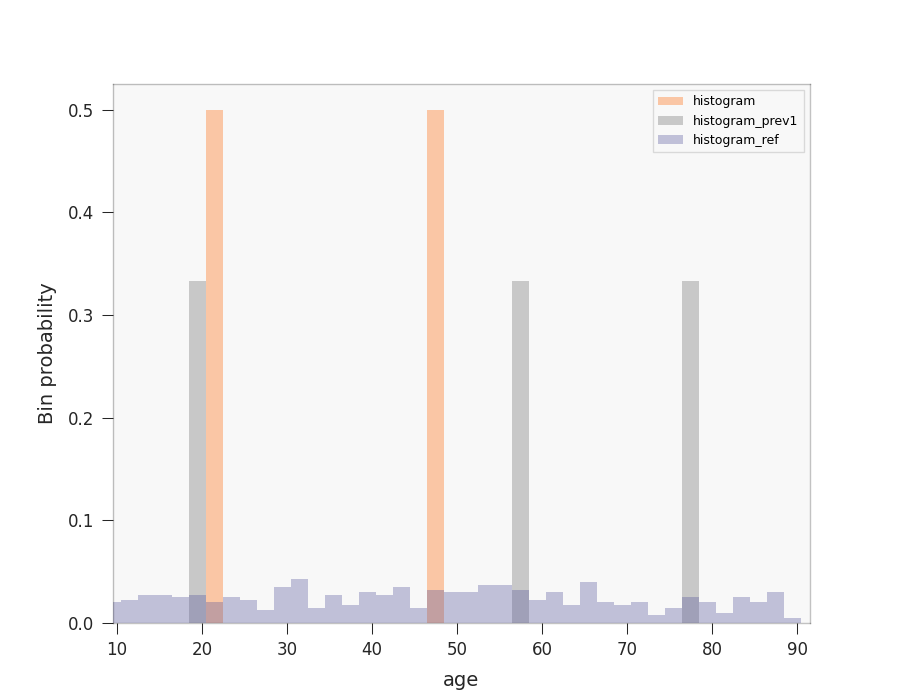
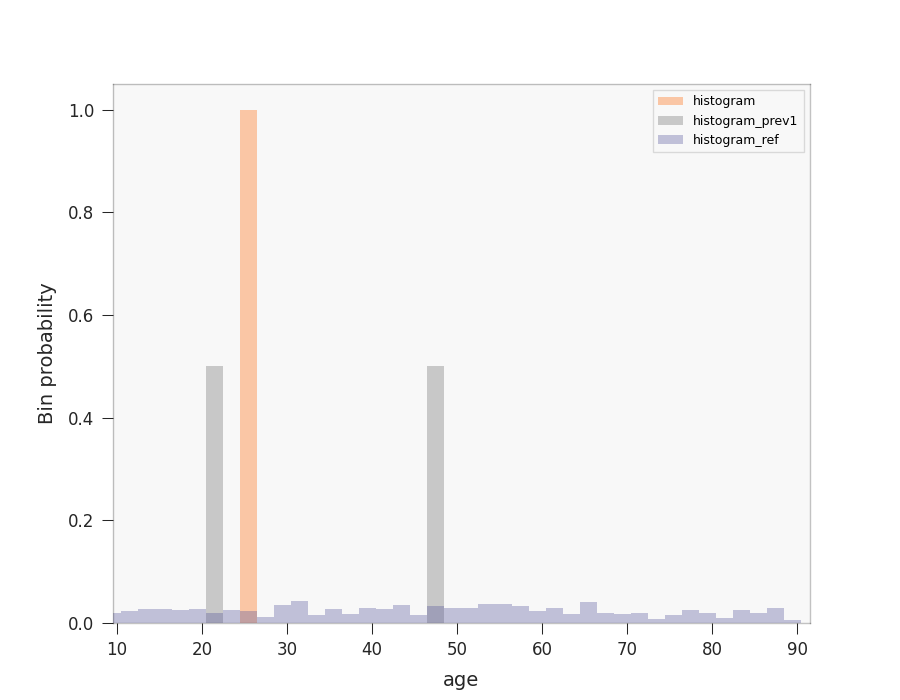
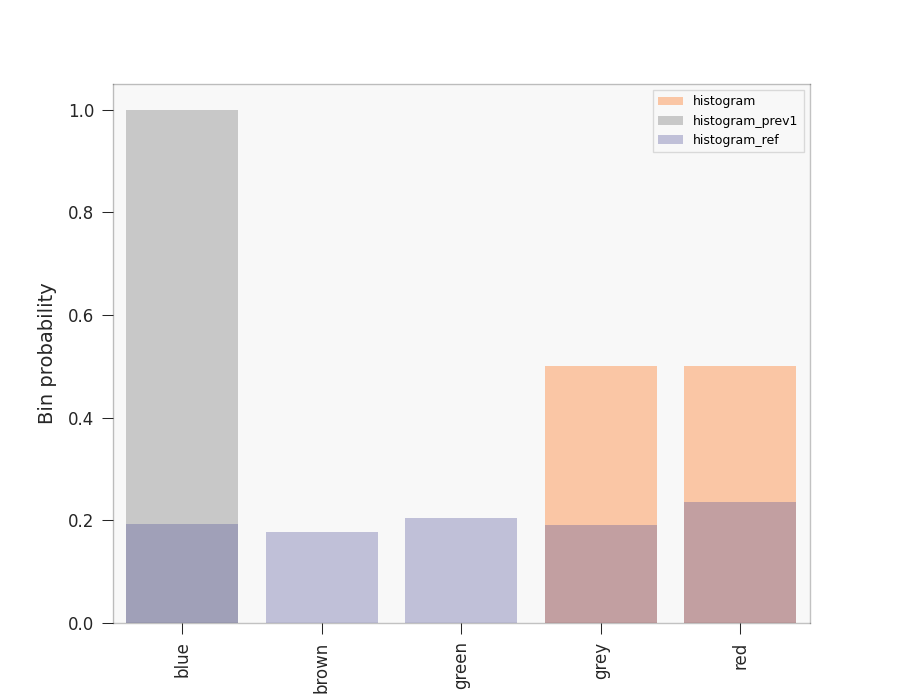
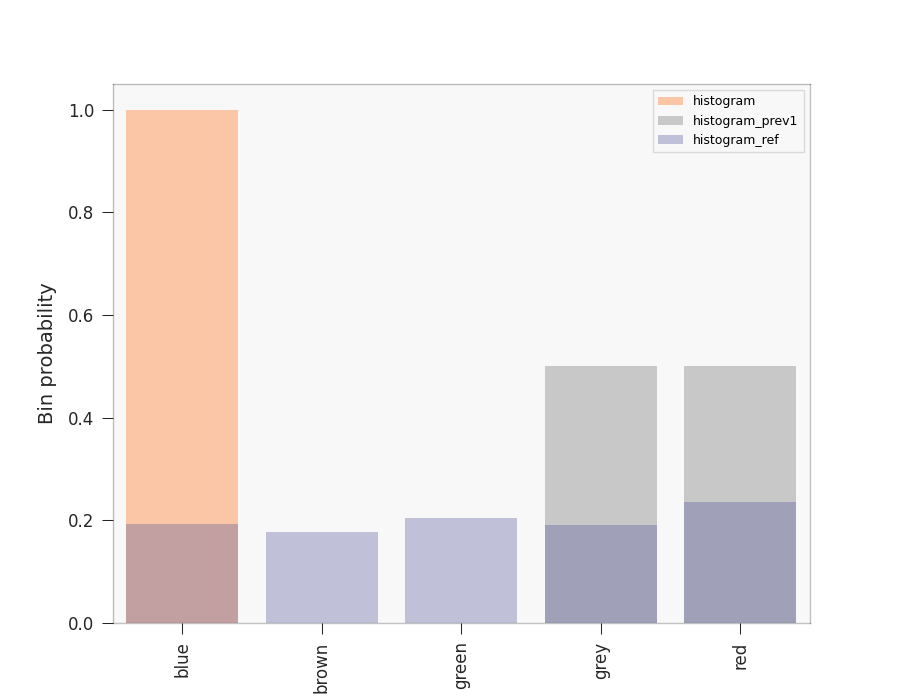
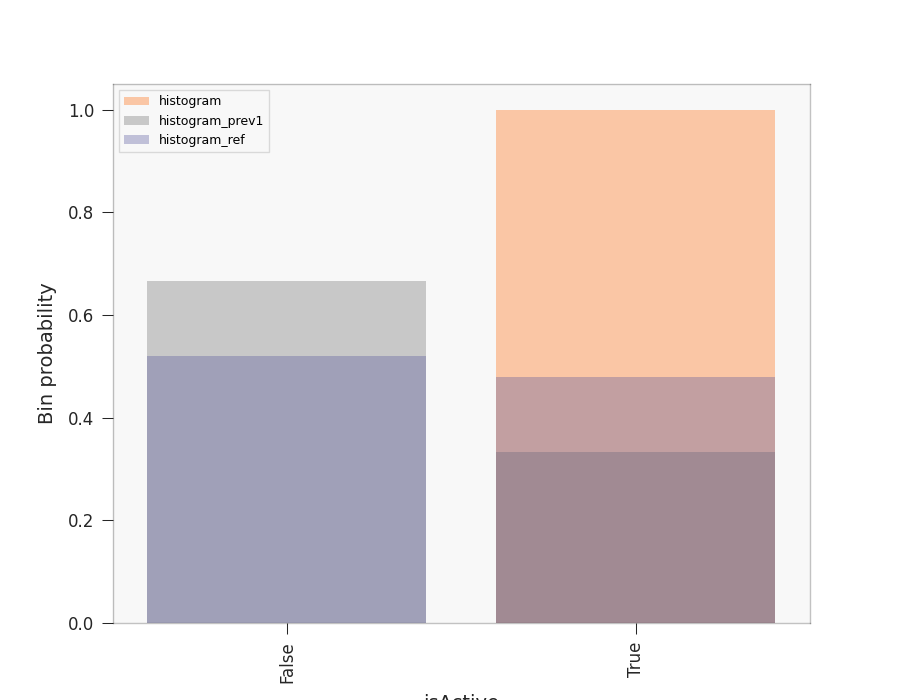
...
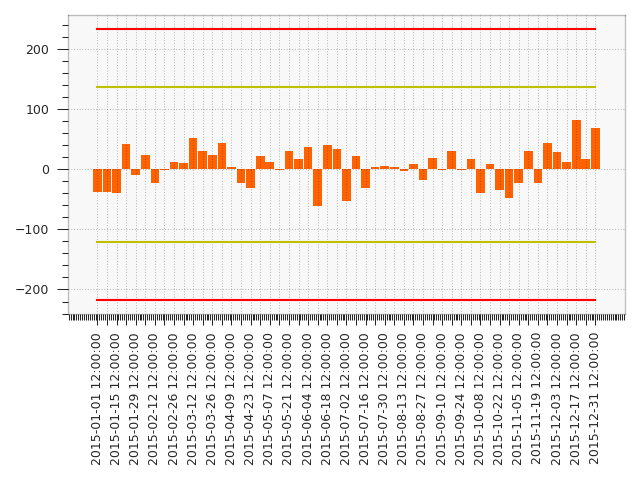
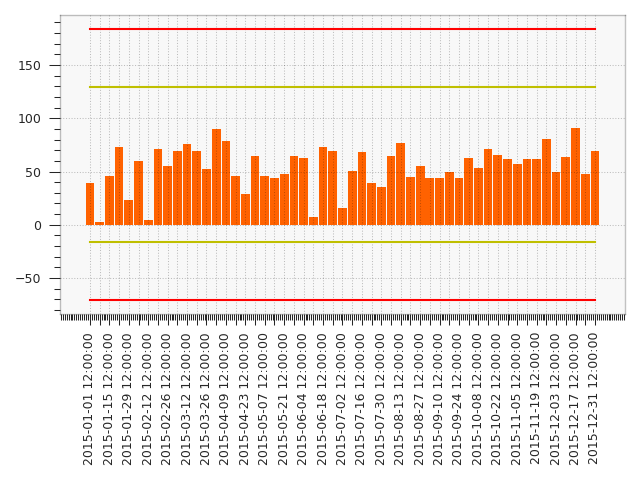
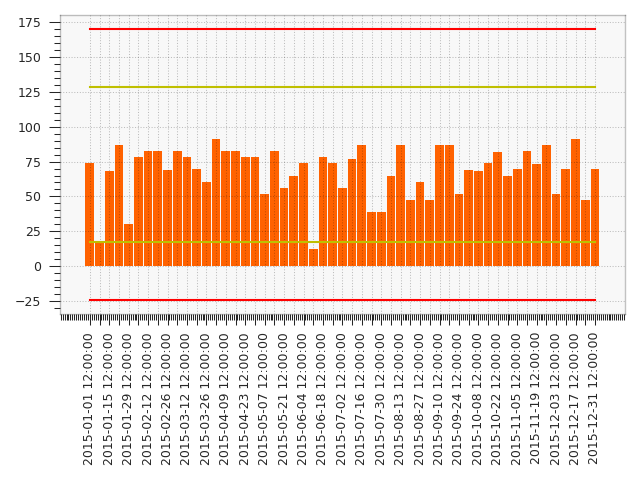
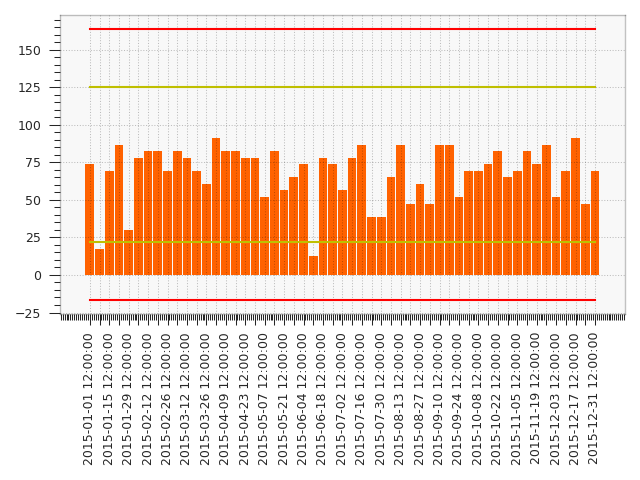
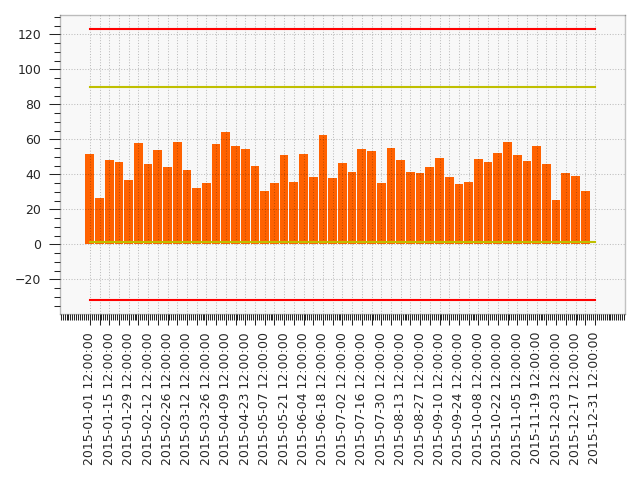

In [20]:
rep = popmon.stability_report(hists)
rep

2022-02-07 10:44:44,905 INFO [hist_splitter]: Splitting histograms "hists" as "split_hists"
2022-02-07 10:44:45,109 INFO [hist_comparer]: Comparing "split_hists" with rolling sum of 1 previous histogram(s).
2022-02-07 10:44:51,400 INFO [hist_comparer]: Comparing "split_hists" with reference "split_hists"
2022-02-07 10:44:52,149 INFO [pull_calculator]: Comparing "comparisons" with median/mad of reference "comparisons"
2022-02-07 10:44:53,144 INFO [hist_profiler]: Profiling histograms "split_hists" as "profiles"
2022-02-07 10:44:53,367 INFO [pull_calculator]: Comparing "profiles" with median/mad of reference "profiles"
2022-02-07 10:44:55,292 INFO [apply_func]: Computing significance of (rolling) trend in means of features
2022-02-07 10:44:55,502 INFO [compute_tl_bounds]: Calculating static bounds for "profiles"
2022-02-07 10:44:55,938 INFO [compute_tl_bounds]: Calculating static bounds for "comparisons"
2022-02-07 10:44:56,209 INFO [compute_tl_bounds]: Calculating traffic light alerts f


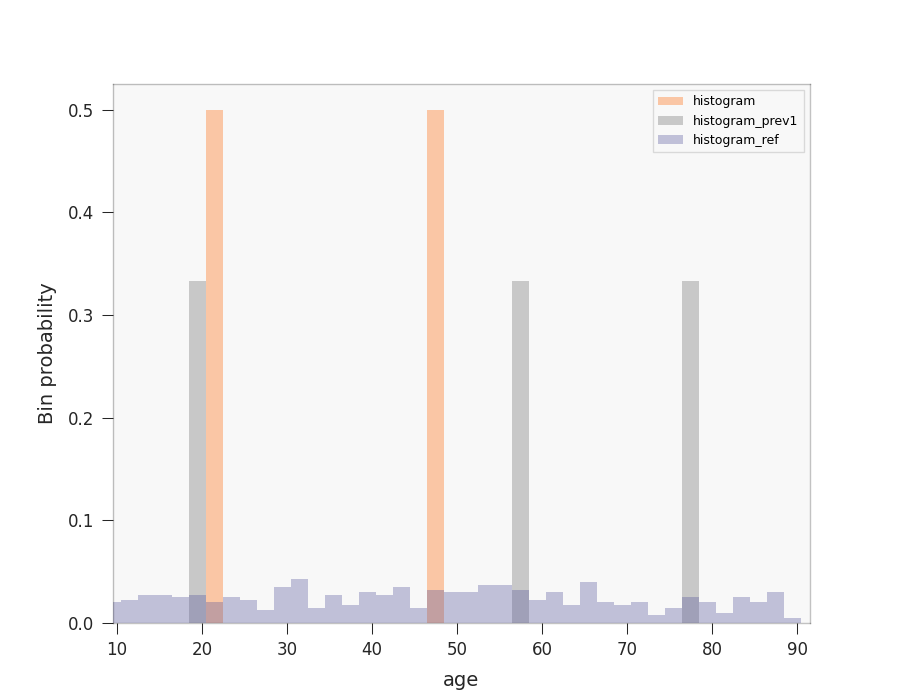
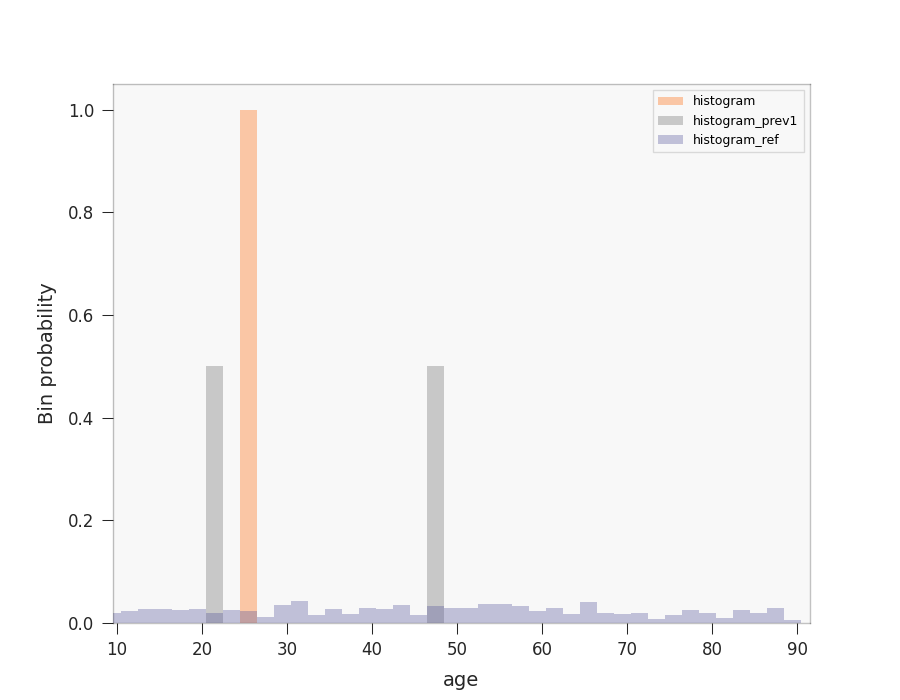
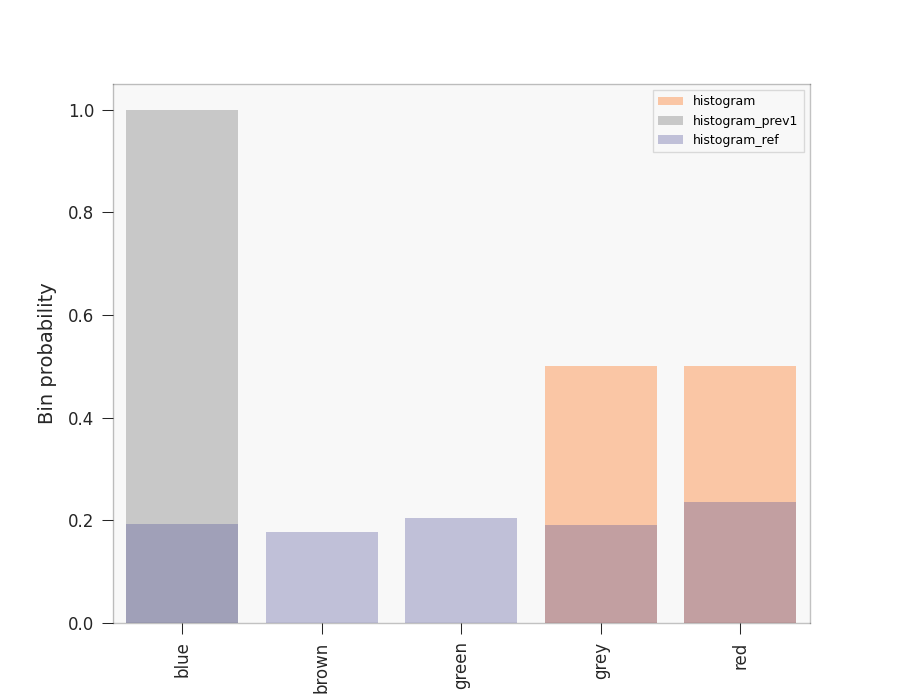
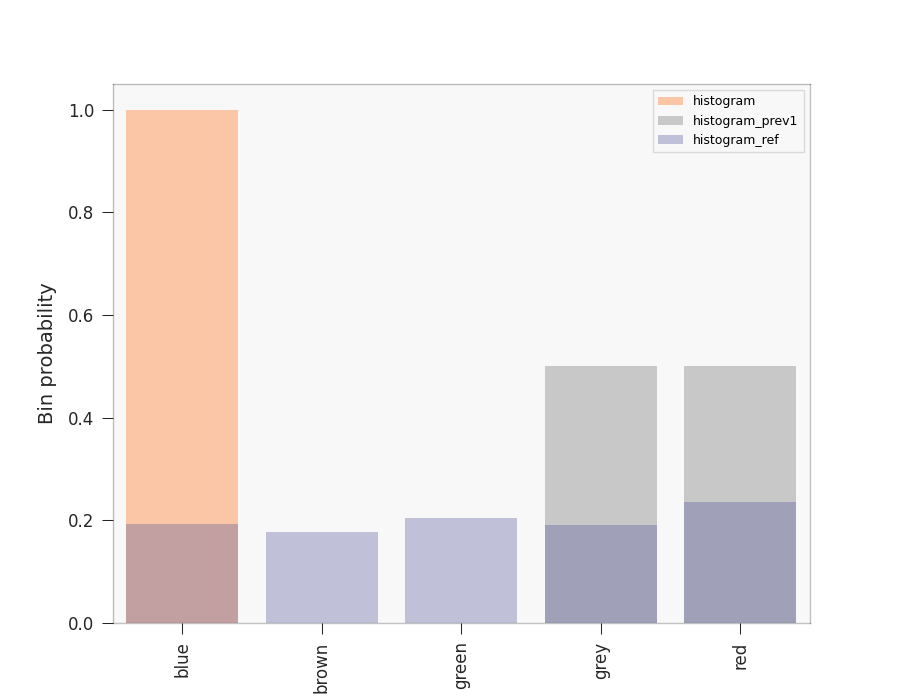
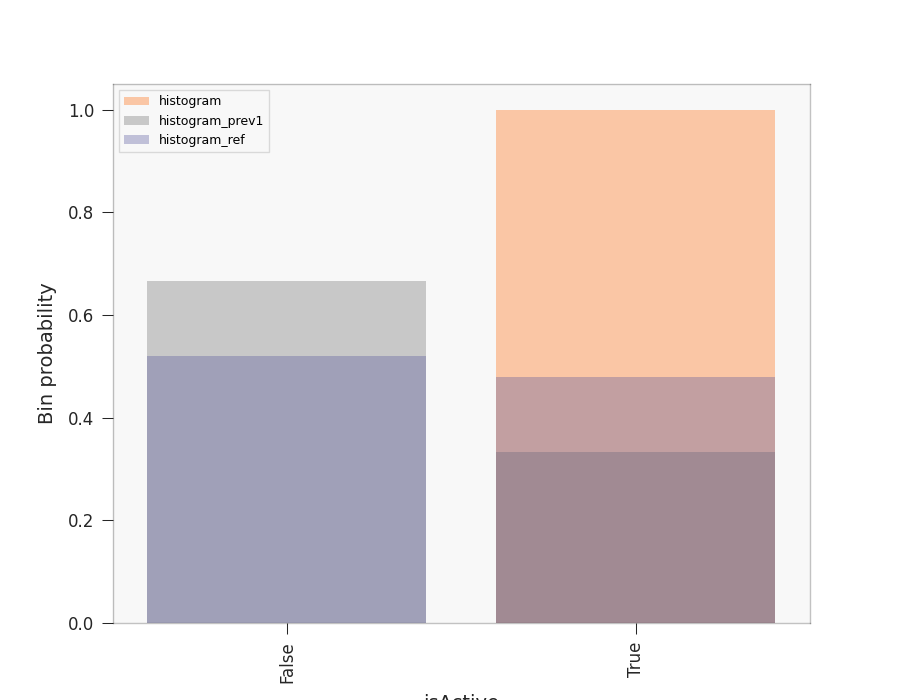
...
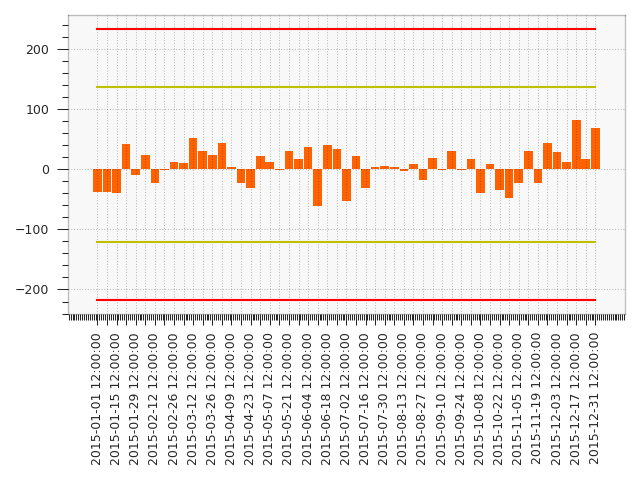
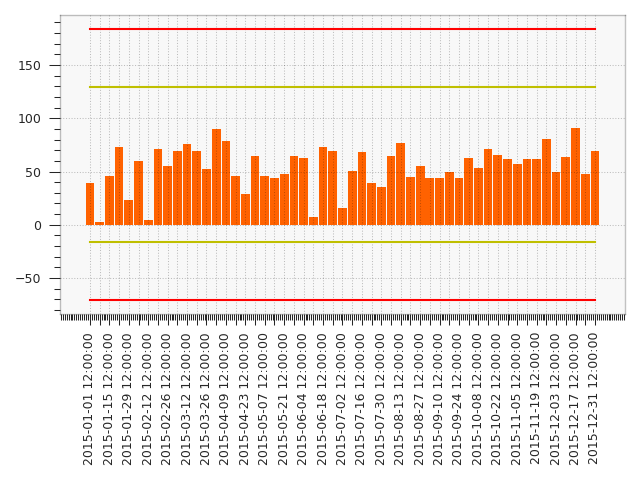
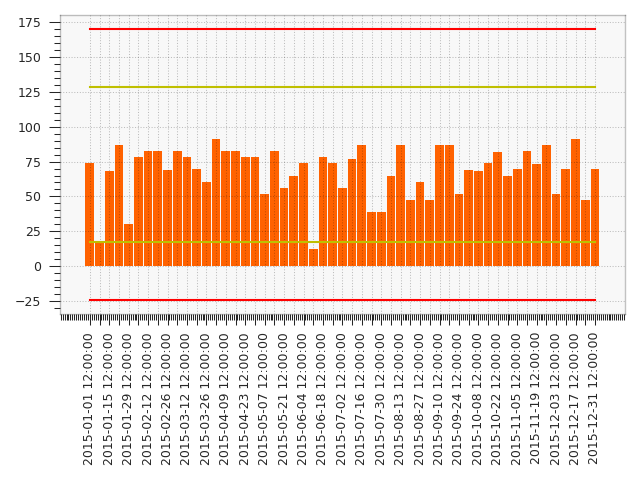
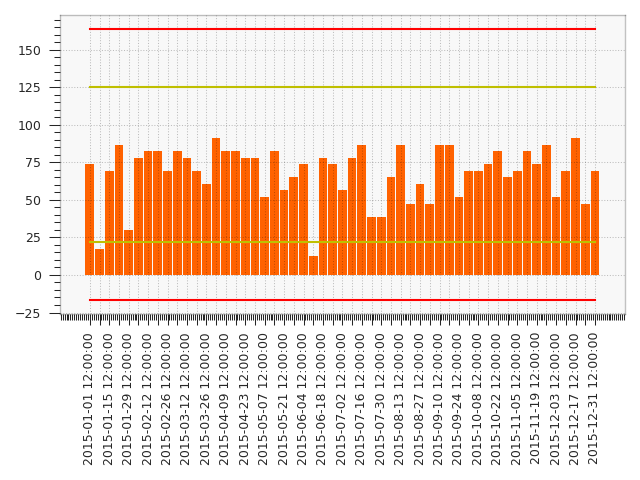
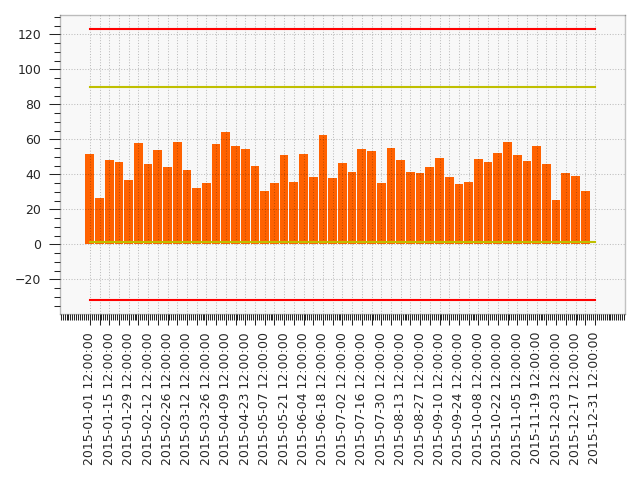

In [21]:
popmon.stability_report(hists2)

In [22]:
# hists_basis is the set of existing histogram
hists_basis = hists
# hists_delta is the new set of histograms
hists_delta = hists_list[-1]

# by default, the stitcher will recognize the existing time-axis "date" in both histogram sets.
# remember that binning along the "date" time-axis is in weeks.

# when adding hists_delta, one can either "add" histograms to existing weeks, or "replace" existing weeks.
# the default is to add them.
hists4 = popmon.stitch_histograms(
    hists_basis=hists_basis, hists_delta=hists_delta, mode="add"
)

In [23]:
# or "replace" histograms found in existing weeks with those in hists_delta:
hists4 = popmon.stitch_histograms(
    hists_basis=hists_basis, hists_delta=hists_delta, mode="replace"
)

2022-02-07 10:46:58,293 INFO [hist_splitter]: Splitting histograms "hists" as "split_hists"
2022-02-07 10:46:58,503 INFO [hist_comparer]: Comparing "split_hists" with rolling sum of 1 previous histogram(s).
2022-02-07 10:46:59,094 INFO [hist_comparer]: Comparing "split_hists" with reference "split_hists"
2022-02-07 10:46:59,627 INFO [pull_calculator]: Comparing "comparisons" with median/mad of reference "comparisons"
2022-02-07 10:47:00,548 INFO [hist_profiler]: Profiling histograms "split_hists" as "profiles"
2022-02-07 10:47:00,798 INFO [pull_calculator]: Comparing "profiles" with median/mad of reference "profiles"
2022-02-07 10:47:02,858 INFO [apply_func]: Computing significance of (rolling) trend in means of features
2022-02-07 10:47:03,065 INFO [compute_tl_bounds]: Calculating static bounds for "profiles"
2022-02-07 10:47:03,506 INFO [compute_tl_bounds]: Calculating static bounds for "comparisons"
2022-02-07 10:47:03,807 INFO [compute_tl_bounds]: Calculating traffic light alerts f


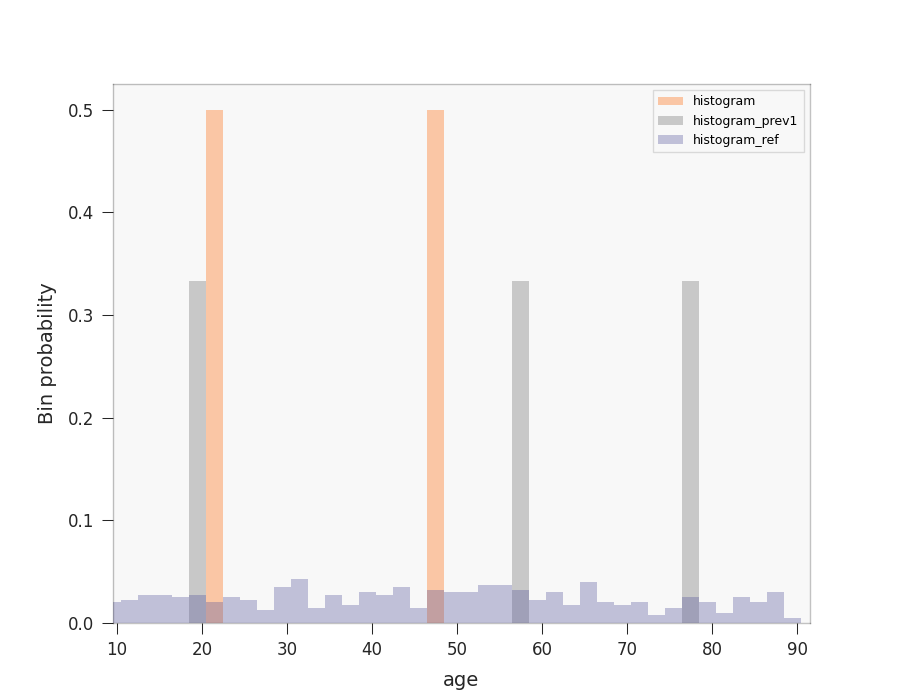
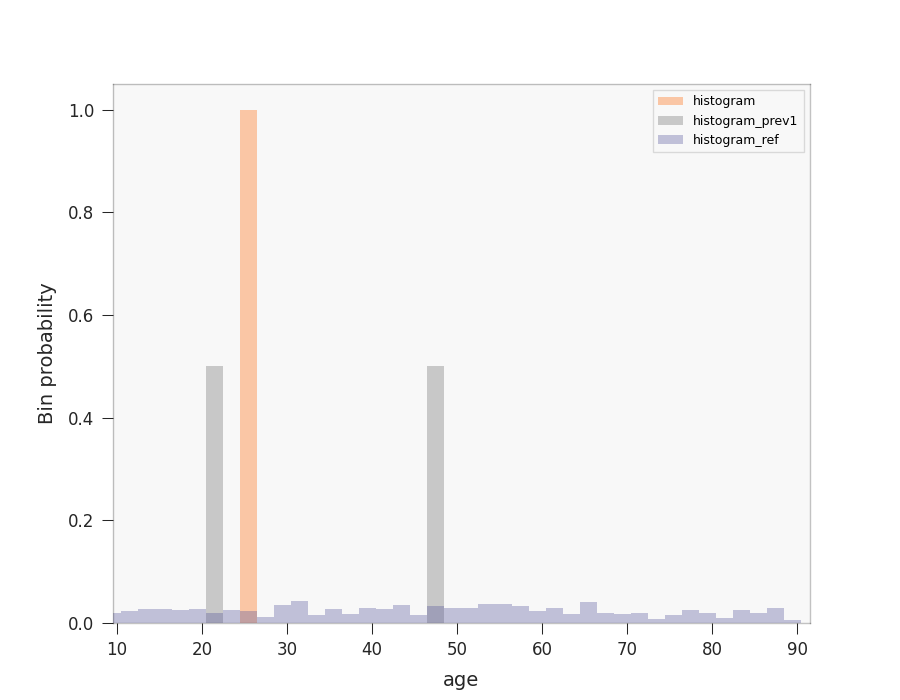
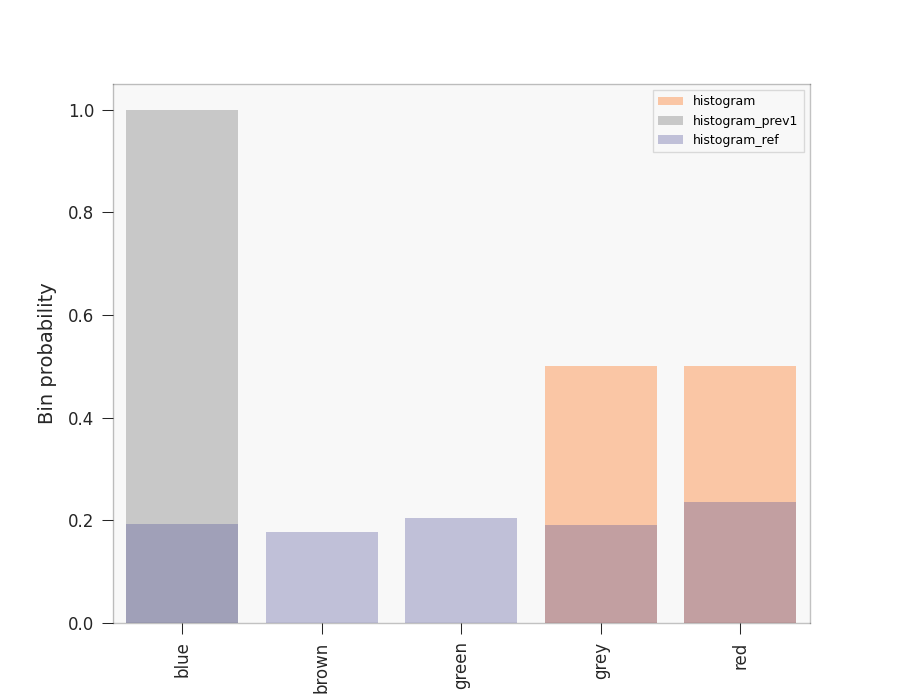
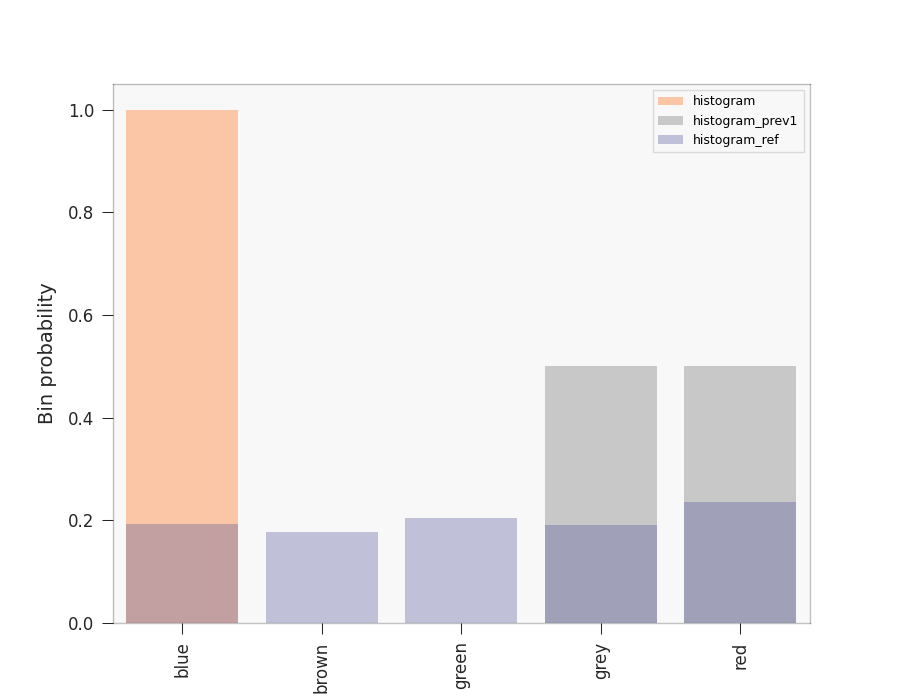
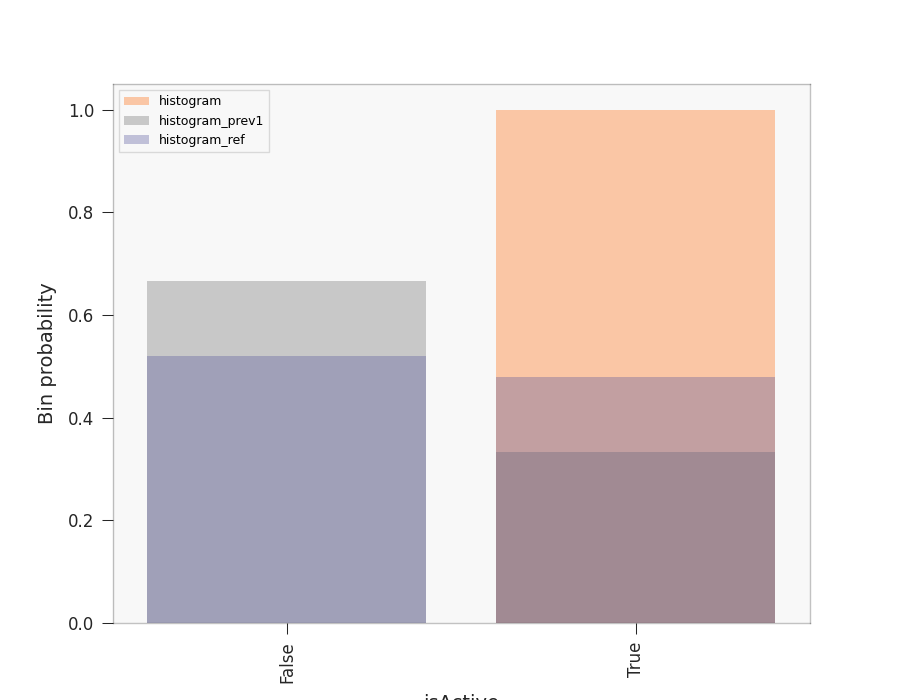
...
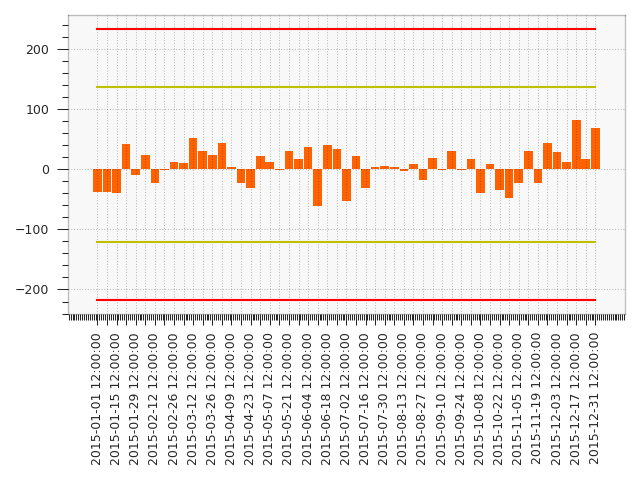
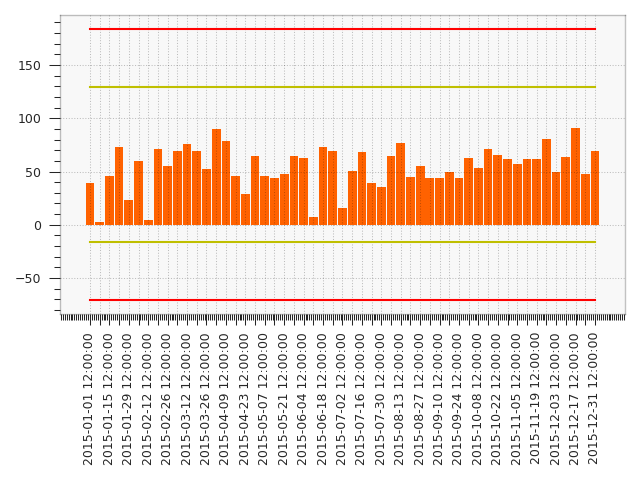
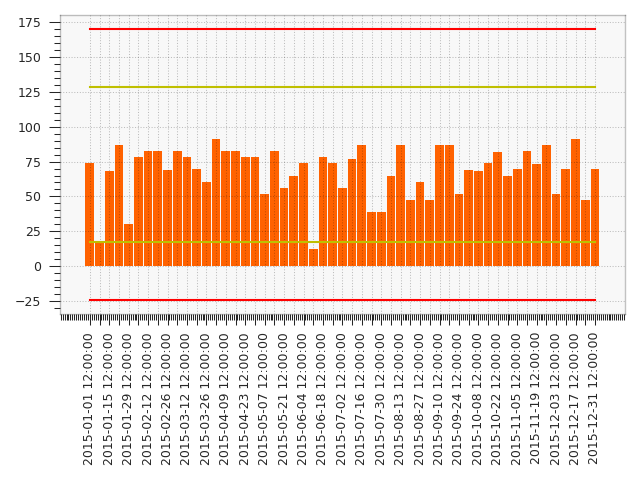
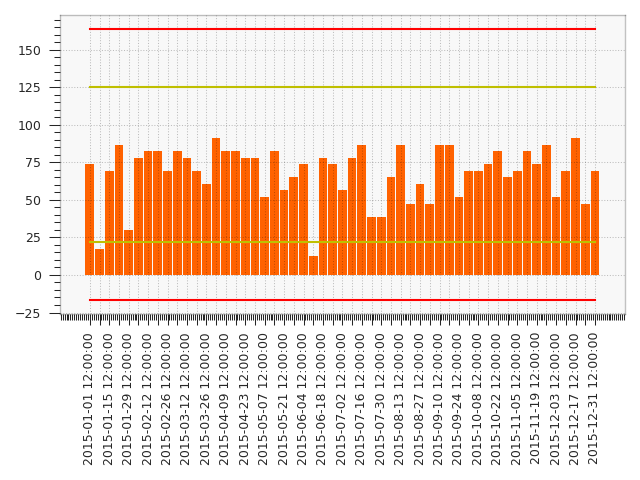
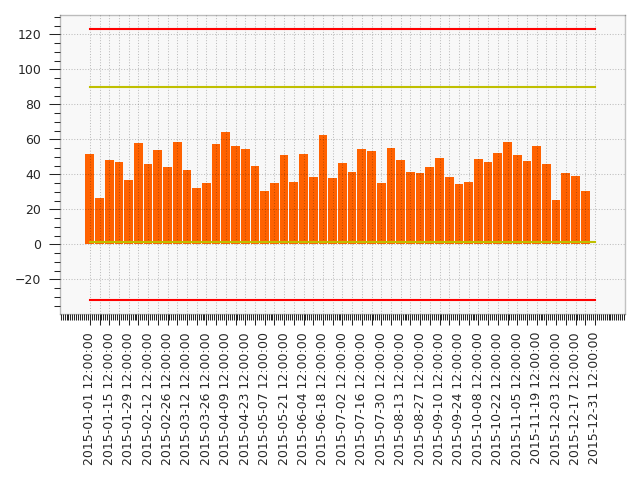

In [24]:
popmon.stability_report(hists4)